In [5]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [6]:
from templates import *

In [7]:
device = 'cuda:0'
conf = ffhq256_autoenc()
# print(conf.name)
model = LitModel(conf)
state = torch.load(f'checkpoints/{conf.name}/last.ckpt', map_location='cpu')
model.load_state_dict(state['state_dict'], strict=False)
model.ema_model.eval()
model.ema_model.to(device);

Global seed set to 0


Model params: 160.69 M


# Interpolation of images aligned by flow-net

Sorted timestamps: [0.0, 0.01, 0.03, 0.04, 0.05, 0.07, 0.08, 0.09, 0.11, 0.12, 0.13, 0.15, 0.16, 0.17, 0.19, 0.2, 0.21, 0.23, 0.24, 0.25, 0.27, 0.28, 0.29, 0.31, 0.32, 0.33, 0.35, 0.36, 0.37, 0.39, 0.4, 0.41, 0.43, 0.44, 0.45, 0.47, 0.48, 0.49, 0.51, 0.52, 0.53, 0.55, 0.56, 0.57, 0.59, 0.6, 0.61, 0.63, 0.64, 0.65, 0.67, 0.68, 0.69, 0.71, 0.72, 0.73, 0.75, 0.76, 0.77, 0.79, 0.8, 0.81, 0.83, 0.84, 0.85, 0.87, 0.88, 0.89, 0.91, 0.92, 0.93, 0.95, 0.96, 0.97, 0.99, 1.0]


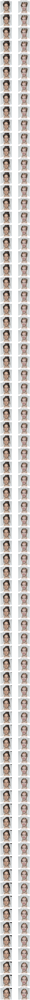

In [11]:
import matplotlib.pyplot as plt
from torchvision.transforms import ToTensor, Normalize, Compose
import os
import re

def get_timestamps(imgs_folder):
    # Regular expression pattern to capture the timestamp from filenames with 'dst_t'
    pattern = re.compile(r'dst_t(\d+\.\d{2})\.png')

    # Initialize a list to store the timestamps
    timestamps = []

    # Loop through all files in the directory
    for filename in os.listdir(imgs_folder):
        # Check if the file matches the naming pattern
        match = pattern.search(filename)
        if match:
            # Extract the timestamp
            timestamps.append(float(match.group(1)))

    # Convert list items to float and sort them
    sorted_timestamps = sorted(timestamps, key=float)

    # Display the sorted timestamps
    print("Sorted timestamps:", sorted_timestamps)
    return sorted_timestamps

# 1. Load the Aligned Images
#image_folder = 'imgs_crop'  # Replace this with your folder path
#timestamps = np.arange(0.0, 1.1, 0.1)

image_folder = 'imgs_interpolate/001_002_75-warpings-crop'
timestamps = get_timestamps(image_folder)

def load_image_pair(timestamp, image_folder):
    src_img_path = os.path.join(image_folder, f'src_t{timestamp:.2f}.png')
    dst_img_path = os.path.join(image_folder, f'dst_t{timestamp:.2f}.png')
    
    src_img = Image.open(src_img_path)
    dst_img = Image.open(dst_img_path)
    
    return src_img, dst_img

src_images = []
dst_images = []

# Plotting the image pairs
fig, axes = plt.subplots(len(timestamps), 2, figsize=(10, 3 * len(timestamps)))

for i, timestamp in enumerate(timestamps):
    src_img, dst_img = load_image_pair(timestamp, image_folder)
    
    src_images.append(src_img)
    dst_images.append(dst_img)

    # Handling the single-row case
    if len(timestamps) == 1:
        current_axes = [axes[0], axes[1]]
    else:
        current_axes = axes[i]
    
    current_axes[0].imshow(src_img)
    current_axes[0].set_title(f'Input: src_{timestamp:.2f}.png')
    current_axes[0].axis('off')
    
    current_axes[1].imshow(dst_img)
    current_axes[1].set_title(f'Input: dst_{timestamp:.2f}.png')
    current_axes[1].axis('off')

plt.tight_layout()
plt.show()

In [12]:
transform = Compose([ToTensor(), Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])

# Lists to store the encodings for each pair
src_semantic_encodings = []
dst_semantic_encodings = []
src_stochastic_encodings = []
dst_stochastic_encodings = []

for i, timestamp in enumerate(timestamps):
    # Convert the PIL images to tensors and normalize them
    src_img_tensor = transform(src_images[i]).unsqueeze(0).to(device)
    dst_img_tensor = transform(dst_images[i]).unsqueeze(0).to(device)
    
    # Encode the Images
    src_cond = model.encode(src_img_tensor)
    dst_cond = model.encode(dst_img_tensor)
    
    src_xT = model.encode_stochastic(src_img_tensor, src_cond, T=250)
    dst_xT = model.encode_stochastic(dst_img_tensor, dst_cond, T=250)
    
    # Append the encodings to the lists
    src_semantic_encodings.append(src_cond[0])
    dst_semantic_encodings.append(dst_cond[0])
    src_stochastic_encodings.append(src_xT[0])
    dst_stochastic_encodings.append(dst_xT[0])


0.0
0.013513513513513514
0.02702702702702703
0.04054054054054054
0.05405405405405406
0.06756756756756757
0.08108108108108109
0.0945945945945946
0.10810810810810811
0.12162162162162163
0.13513513513513514
0.14864864864864866
0.16216216216216217
0.17567567567567569
0.1891891891891892
0.20270270270270271
0.21621621621621623
0.22972972972972974
0.24324324324324326
0.25675675675675674
0.2702702702702703
0.28378378378378377
0.2972972972972973
0.3108108108108108
0.32432432432432434
0.33783783783783783
0.35135135135135137
0.36486486486486486
0.3783783783783784
0.3918918918918919
0.40540540540540543
0.4189189189189189
0.43243243243243246
0.44594594594594594
0.4594594594594595
0.47297297297297297
0.4864864864864865
0.5
0.5135135135135135
0.527027027027027
0.5405405405405406
0.5540540540540541
0.5675675675675675
0.581081081081081
0.5945945945945946
0.6081081081081081
0.6216216216216216
0.6351351351351351
0.6486486486486487
0.6621621621621622
0.6756756756756757
0.6891891891891891
0.702702702702702

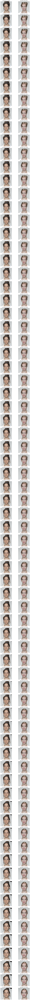

In [13]:
from scipy.interpolate import CubicSpline

# Lists to store the rendered images for each encoded pair
rendered_src_images = []
rendered_dst_images = []

resampled_src_cond = []
resampled_dst_cond = []
resampled_src_xT = []
resampled_dst_xT = []

N = 75 #number of points

fig, axes = plt.subplots(N, 2, figsize=(10, 3 * N))

def bezier(points, t):
    n = len(points)
    point = 0.0*points[0]
    for i in range(n):
        c = math.comb(n-1,i)
        point += c*pow(1-t,n-1-i)*pow(t,i)*points[i]
    return point

def linear(points, t): #t in [0, n]
    n = len(points)
    t *= n-1
    point = 0.0*points[0]
    for i in range(n):
        if t >= i and t<=i+1:
            s = t-i
            return (1-s)*points[i] + s*points[i+1]

    return point


def cos(a, b):
    a = a.view(-1)
    b = b.view(-1)
    a = F.normalize(a, dim=0)
    b = F.normalize(b, dim=0)
    return (a * b).sum()

def slerp(points, t): #t in [0, n]
    
    n = len(points)
    t *= n-1
    point = 0.0*points[0]
    for i in range(n):
        if t >= i and t<=i+1:
            s = t-i
            theta = torch.arccos(cos(points[i], points[i+1]))
            x_shape = points[0].shape
            point = (torch.sin((1 - s) * theta) * points[i].flatten(0, 2)[None] + torch.sin(s * theta) * points[i+1].flatten(0, 2)[None]) / torch.sin(theta)
            
            point_1= (1 - s) * points[i].flatten(0, 2)[None] + s * points[i+1].flatten(0, 2)[None]

            point= 0.2*point_1 +  0.8*point
            
            point = point.view(-1, *x_shape)


            return point

    return point

def spline(points, times):
    return CubicSpline(times, points)

n_times = len(src_semantic_encodings)
times = [i/(n_times-1) for i in range(n_times)]

# src_semantic_cpu = [enc.cpu() for enc in src_semantic_encodings]
# dst_semantic_cpu = [enc.cpu() for enc in dst_semantic_encodings]
# src_stochastic_cpu = [enc.cpu() for enc in src_stochastic_encodings]
# dst_stochastic_cpu = [enc.cpu() for enc in dst_stochastic_encodings]

# cs_src_cond = CubicSpline(times, src_semantic_cpu)
# cs_dst_cond = CubicSpline(times, dst_semantic_cpu)

# cs_src_xT = CubicSpline(times, src_stochastic_cpu)
# cs_dst_xT = CubicSpline(times, dst_stochastic_cpu)

#for i, timestamp in enumerate(timestamps):
for i in range(N): 
    #time
    t = i/(N-1)
    print(t)

    # sampling at the encoding curves
    # src_cond = src_semantic_encodings[i]
    # dst_cond = dst_semantic_encodings[i]
    
    # src_cond = bezier(src_semantic_encodings, t)
    # dst_cond = bezier(dst_semantic_encodings, t)

    src_cond = linear(src_semantic_encodings, t)
    dst_cond = linear(dst_semantic_encodings, t)

    # src_cond = torch.tensor(cs_src_cond(t), dtype=torch.float32, device=device)
    # dst_cond = torch.tensor(cs_dst_cond(t), dtype=torch.float32, device=device)
    
    # print(dst_cond)

    # src_xT = src_stochastic_encodings[i]
    # # dst_xT = dst_stochastic_encodings[i]
    # src_xT = bezier(src_stochastic_encodings, t)
    # dst_xT = bezier(dst_stochastic_encodings, t)

    src_xT = slerp(src_stochastic_encodings, t)
    dst_xT = slerp(dst_stochastic_encodings, t)
    
    # src_xT = torch.tensor(cs_src_xT(t), device=device)
    # dst_xT = torch.tensor(cs_dst_xT(t), device=device)
    
    # Render the Images from the Encodings
    rendered_src = model.render(src_xT, src_cond[None], T=20)[0]
    rendered_dst = model.render(dst_xT, dst_cond[None], T=20)[0]
    
    # Append to lists
    rendered_src_images.append(rendered_src)
    rendered_dst_images.append(rendered_dst)

    resampled_src_cond.append(src_cond)
    resampled_dst_cond.append(dst_cond)
    resampled_src_xT.append(src_xT)
    resampled_dst_xT.append(dst_xT)
    
    # Handling the single-row case
    if N == 1:
        current_axes = [axes[0], axes[1]]
    else:
        current_axes = axes[i]
    
    # Plot the Original and Rendered Images Side-by-Side
    current_axes[0].imshow(rendered_src.cpu().numpy().transpose(1, 2, 0))
    current_axes[0].set_title(f'Decoded: src_{i}.png')
    current_axes[0].axis('off')
    
    current_axes[1].imshow(rendered_dst.cpu().numpy().transpose(1, 2, 0))
    current_axes[1].set_title(f'Decoded: dst_{i}.png')
    current_axes[1].axis('off')

plt.tight_layout()
plt.show()

Semantic codes are interpolated using convex combination, while stochastic codes are interpolated using spherical linear interpolation.

In [23]:
# Lists to store all interpolated images for each pair
all_interpolated_images = []

def cos(a, b):
    a = a.view(-1)
    b = b.view(-1)
    a = F.normalize(a, dim=0)
    b = F.normalize(b, dim=0)
    return (a * b).sum()

for i in range(len(resampled_src_cond)):

    t = i/(len(resampled_src_cond)-1)
    # Retrieve the stored encodings
    src_cond = resampled_src_cond[i]
    dst_cond = resampled_dst_cond[i]

    src_xT = resampled_src_xT[i]
    dst_xT = resampled_dst_xT[i]
    
    #timestamps_gpu = torch.tensor(timestamps).type(torch.HalfTensor).to(device=device)

    # Interpolate the Codes
    semantic_intp = src_cond[None] * (1 - t) + dst_cond[None] * t

    #print(f'Alpha: {alpha}')
    #print(f'Semantic Intp: {semantic_intp}')

    # Normalize to avoid values outside the arccos expected parameter range [-1, 1]
    src_xT_normalized = src_xT / torch.norm(src_xT)
    dst_xT_normalized = dst_xT / torch.norm(dst_xT)

    dot_product = (src_xT_normalized * dst_xT_normalized).sum()
    theta = torch.arccos(dot_product)
    x_shape = src_xT.shape
    stochastic_slerp = (torch.sin((1 - t) * theta) * src_xT.flatten(0, 2)[None] + torch.sin(t * theta) * dst_xT.flatten(0, 2)[None]) / torch.sin(theta)
    stochastic_linear= (1 - t) * src_xT.flatten(0, 2)[None] + t * dst_xT.flatten(0, 2)[None]

    stochastic_slerp= 0.15*stochastic_linear +  0.85*stochastic_slerp
    
    stochastic_slerp = stochastic_slerp.view(-1, *x_shape)


    #print(f'Dot product: {dot_product}')
    #print(f'Theta: {theta}')
    #print(f'Stochastic Intp: {stochastic_intp}')

    # Render the Interpolated Images
    interpolated_images = model.render(stochastic_slerp.squeeze(0), semantic_intp, T=30)
    all_interpolated_images.append(interpolated_images)

torch.Size([3, 256, 256])
torch.Size([3, 256, 256])
torch.Size([3, 256, 256])
torch.Size([3, 256, 256])
torch.Size([3, 256, 256])
torch.Size([3, 256, 256])
torch.Size([3, 256, 256])
torch.Size([3, 256, 256])
torch.Size([3, 256, 256])
torch.Size([3, 256, 256])
torch.Size([3, 256, 256])
torch.Size([3, 256, 256])
torch.Size([3, 256, 256])
torch.Size([3, 256, 256])
torch.Size([3, 256, 256])
torch.Size([3, 256, 256])
torch.Size([3, 256, 256])
torch.Size([3, 256, 256])
torch.Size([3, 256, 256])
torch.Size([3, 256, 256])
torch.Size([3, 256, 256])
torch.Size([3, 256, 256])
torch.Size([3, 256, 256])
torch.Size([3, 256, 256])
torch.Size([3, 256, 256])
torch.Size([3, 256, 256])
torch.Size([3, 256, 256])
torch.Size([3, 256, 256])
torch.Size([3, 256, 256])
torch.Size([3, 256, 256])
torch.Size([3, 256, 256])
torch.Size([3, 256, 256])
torch.Size([3, 256, 256])
torch.Size([3, 256, 256])
torch.Size([3, 256, 256])
torch.Size([3, 256, 256])
torch.Size([3, 256, 256])
torch.Size([3, 256, 256])
torch.Size([

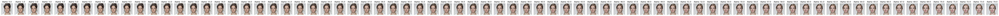

In [25]:
# Function to plot the interpolated images
def plot_interpolated_images(all_interpolated_images, timestamps):
    # Number of interpolation stages
    num_stages = len(all_interpolated_images)
    
    # Create a grid for plotting
    fig, axes = plt.subplots(1, len(all_interpolated_images), figsize=(10*9, 10))

    for i, interpolated_images in enumerate(all_interpolated_images):
        #for j, img_tensor in enumerate(interpolated_images):
        # Convert tensor image to numpy array for plotting
        img_tensor = interpolated_images.squeeze(0)
        print(img_tensor.shape)
        img_array = img_tensor.cpu().detach().numpy().transpose(1, 2, 0)   # De-normalize

        #min_value = img_tensor.min().item()
        #max_value = img_tensor.max().item()
        #print(f"Interpolated Image [{i}, {i}] - Min Value: {min_value}, Max Value: {max_value}")

        #ax = axes[i][j] if len(timestamps) > 1 else axes[j]
        ax = axes[i]
        ax.imshow(img_array)
        ax.axis('off')
        #if i == 0:
        #ax.set_title(f'Alpha: {j / (num_stages-1):.1f}')
        ax.set_title(f'Alpha: {i:.1f}')
    
    plt.tight_layout()
    plt.show()

# Plotting the interpolated images
plot_interpolated_images(all_interpolated_images, timestamps)

In [26]:
from utils import output_video

output_video(all_interpolated_images, 'results/flow_diffae_0.2_0.8.mp4')